In [1]:
import pandas as pd
from gensim.models.keyedvectors import KeyedVectors
from sklearn.feature_extraction.text import CountVectorizer,TfidfVectorizer
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer, SnowballStemmer
from nltk.stem.porter import *
from textblob import TextBlob
import nltk
STOPWORDS=stopwords.words('english')

In [2]:
df = pd.read_excel(r"C:\Users\surya\Desktop\Jupyter Python Programs\Amazon Review NLP\Games_excel.xlsx", usecols = ['reviewText', 'helpful'])
df.head()

,helpful,reviewText
0,"[8, 12]",Installing the game was a struggle (because of...
1,"[0, 0]",If you like rally cars get this game you will ...
2,"[0, 0]",1st shipment received a book instead of the ga...
3,"[7, 10]","I got this version instead of the PS3 version,..."
4,"[2, 2]",I had Dirt 2 on Xbox 360 and it was an okay ga...


In [3]:
df['reviewText']=df['reviewText'].apply(str)

In [4]:
##Remove Punctuations 
import re
def remove_punctuation(text):
    return re.sub(r'[^\w\s]','',text)

## Remove Numbers
def remove_numbers(text):
    return re.sub(r'\d+', '', text)

##Remove Special Symbols
def special_characters(text):
    return re.sub('[^A-Za-z]+',' ', text)

### Lemmatize word
def lemmatize(text):
    return WordNetLemmatizer().lemmatize(text, pos='v')

## Spell Correct
def Spell_correct(text):
    return str(TextBlob(text).correct())

In [5]:
reviews = list(df['reviewText'])

In [6]:
reviews

['Installing the game was a struggle (because of games for windows live bugs).Some championship races and cars can only be "unlocked" by buying them as an addon to the game. I paid nearly 30 dollars when the game was new. I don\'t like the idea that I have to keep paying to keep playing.I noticed no improvement in the physics or graphics compared to Dirt 2.I tossed it in the garbage and vowed never to buy another codemasters game. I\'m really tired of arcade style rally/racing games anyway.I\'ll continue to get my fix from Richard Burns Rally, and you should to. :)http://www.amazon.com/Richard-Burns-Rally-PC/dp/B000C97156/ref=sr_1_1?ie=UTF8&qid;=1341886844&sr;=8-1&keywords;=richard+burns+rallyThank you for reading my review! If you enjoyed it, be sure to rate it as helpful.',
 "If you like rally cars get this game you will have fun.It is more oriented to &#34;European market&#34; since here in America there isn't a huge rally fan party. Music it is very European and even the voices fro

In [7]:
def preprocess(text):
    text = remove_punctuation(text)
    text = remove_numbers(text)
    text = special_characters(text)
    text= text.lower()
    result = []
    tokens=text.split(" ")
    tokens=[token for token in tokens if not token in STOPWORDS]
    tokens=[lemmatize(token) for token in tokens]
    result=' '.join(tokens)
    return result

In [8]:
Cleaned_Reviews = [preprocess(review) for review in reviews]

In [9]:
Cleaned_Reviews[0]

'instal game struggle game windows live bugssome championship race cars unlock buy addon game pay nearly dollars game new dont like idea keep pay keep playingi notice improvement physics graphics compare dirt toss garbage vow never buy another codemasters game im really tire arcade style rallyracing game anywayill continue get fix richard burn rally httpwwwamazoncomrichardburnsrallypcdpbcrefsr ieutfqidsrkeywordsrichardburnsrallythank read review enjoy sure rate helpful'

In [10]:
reviews[0]

'Installing the game was a struggle (because of games for windows live bugs).Some championship races and cars can only be "unlocked" by buying them as an addon to the game. I paid nearly 30 dollars when the game was new. I don\'t like the idea that I have to keep paying to keep playing.I noticed no improvement in the physics or graphics compared to Dirt 2.I tossed it in the garbage and vowed never to buy another codemasters game. I\'m really tired of arcade style rally/racing games anyway.I\'ll continue to get my fix from Richard Burns Rally, and you should to. :)http://www.amazon.com/Richard-Burns-Rally-PC/dp/B000C97156/ref=sr_1_1?ie=UTF8&qid;=1341886844&sr;=8-1&keywords;=richard+burns+rallyThank you for reading my review! If you enjoyed it, be sure to rate it as helpful.'

In [11]:
tfidf_vectorizer = TfidfVectorizer(min_df=0.02,max_df=0.90,max_features=10000) 
#vectorizer = TfidfVectorizer(stop_words=STOPWORDS)
# tokenize and build vocab
tfidf_vectorizer.fit(Cleaned_Reviews)
# summarize
#print(tfidf_vectorizer.vocabulary_)
# encode document
vector = tfidf_vectorizer.transform(Cleaned_Reviews)
TFIDF = pd.DataFrame(vector.toarray(), columns=tfidf_vectorizer.get_feature_names())
print(TFIDF)

       abilities  ability      able  absolutely  access   account  across  \
0            0.0      0.0  0.000000    0.000000     0.0  0.000000     0.0   
1            0.0      0.0  0.000000    0.000000     0.0  0.000000     0.0   
2            0.0      0.0  0.000000    0.000000     0.0  0.000000     0.0   
3            0.0      0.0  0.045103    0.000000     0.0  0.066157     0.0   
4            0.0      0.0  0.000000    0.000000     0.0  0.000000     0.0   
...          ...      ...       ...         ...     ...       ...     ...   
28128        0.0      0.0  0.000000    0.000000     0.0  0.000000     0.0   
28129        0.0      0.0  0.000000    0.000000     0.0  0.000000     0.0   
28130        0.0      0.0  0.057681    0.073431     0.0  0.000000     0.0   
28131        0.0      0.0  0.000000    0.000000     0.0  0.000000     0.0   
28132        0.0      0.0  0.000000    0.000000     0.0  0.000000     0.0   

            act    action  actual  ...     wrong      xbox        xp  year 

### Extracting Top relavant keywords for a document using Tf-idf

In [12]:
def sort_coo(coo_matrix):
    tuples = zip(coo_matrix.col, coo_matrix.data)
    return sorted(tuples, key=lambda x: (x[1], x[0]), reverse=True)
 
def extract_topn_from_vector(feature_names, sorted_items,topn):
    """get the feature names and tf-idf score of top n items"""
    
    #use only topn items from vector
    sorted_items = sorted_items[:topn]
 
    score_vals = []
    feature_vals = []
    
    # word index and corresponding tf-idf score
    for idx, score in sorted_items:
        
        #keep track of feature name and its corresponding score
        score_vals.append(round(score, 3))
        feature_vals.append(feature_names[idx])
 
    #create a tuples of feature,score
    #results = zip(feature_vals,score_vals)
    results= {}
    for idx in range(len(feature_vals)):
        results[feature_vals[idx]]=score_vals[idx]
    
    return results

In [13]:
feature_names=tfidf_vectorizer.get_feature_names()

In [14]:
feature_names

['abilities',
 'ability',
 'able',
 'absolutely',
 'access',
 'account',
 'across',
 'act',
 'action',
 'actual',
 'actually',
 'add',
 'addictive',
 'addition',
 'advance',
 'adventure',
 'age',
 'ago',
 'ai',
 'alien',
 'allow',
 'almost',
 'alone',
 'along',
 'alot',
 'already',
 'also',
 'although',
 'always',
 'amaze',
 'amazon',
 'amount',
 'annoy',
 'another',
 'anyone',
 'anything',
 'anyway',
 'appear',
 'area',
 'areas',
 'arent',
 'armor',
 'around',
 'art',
 'aside',
 'ask',
 'aspect',
 'aspects',
 'atmosphere',
 'attack',
 'attempt',
 'attention',
 'available',
 'average',
 'avoid',
 'away',
 'awesome',
 'back',
 'background',
 'bad',
 'balance',
 'base',
 'basic',
 'basically',
 'battle',
 'beat',
 'beautiful',
 'become',
 'begin',
 'behind',
 'believe',
 'best',
 'better',
 'beyond',
 'big',
 'biggest',
 'bite',
 'black',
 'blast',
 'blow',
 'book',
 'bore',
 'boss',
 'bother',
 'box',
 'break',
 'bring',
 'buck',
 'bug',
 'build',
 'button',
 'buy',
 'call',
 'camera',


In [15]:
doc=Cleaned_Reviews[0]
doc

'instal game struggle game windows live bugssome championship race cars unlock buy addon game pay nearly dollars game new dont like idea keep pay keep playingi notice improvement physics graphics compare dirt toss garbage vow never buy another codemasters game im really tire arcade style rallyracing game anywayill continue get fix richard burn rally httpwwwamazoncomrichardburnsrallypcdpbcrefsr ieutfqidsrkeywordsrichardburnsrallythank read review enjoy sure rate helpful'

In [16]:
tf_idf_vector=tfidf_vectorizer.transform([doc])
tf_idf_vector.toarray()

array([[0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.14111494, 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.  

In [17]:
sorted_items=sort_coo(tf_idf_vector.tocoo())
sorted_items

[(511, 0.34206047754315677),
 (378, 0.2695732854979862),
 (710, 0.22429595585719952),
 (563, 0.2238583931032989),
 (740, 0.2226403557499704),
 (91, 0.22112035841434863),
 (466, 0.21188063742465965),
 (478, 0.20602143530590022),
 (142, 0.20166507999501784),
 (558, 0.19576670469530072),
 (361, 0.1940827262704375),
 (348, 0.1906709090692421),
 (777, 0.18812995242632644),
 (130, 0.18636777025202403),
 (675, 0.18451232732552725),
 (274, 0.18321313098739325),
 (408, 0.18153503441930252),
 (566, 0.16658878709621908),
 (681, 0.15240312750676213),
 (584, 0.14612183522274327),
 (33, 0.14111494232246902),
 (469, 0.13413940263833607),
 (217, 0.13286069625366076),
 (352, 0.1308306960749353),
 (470, 0.1128030273133302),
 (191, 0.1043091819383043),
 (570, 0.10025364160161847),
 (308, 0.098507821580332),
 (400, 0.07889734947341798),
 (300, 0.07617752567898387)]

In [18]:
keywords=extract_topn_from_vector(feature_names,sorted_items,5)
keywords

{'pay': 0.342, 'keep': 0.27, 'tire': 0.224, 'rate': 0.224, 'unlock': 0.223}

In [19]:
# you only needs to do this once, this is a mapping of index to 
feature_names=tfidf_vectorizer.get_feature_names()
 
# get the document that we want to extract keywords from
#doc=Cleaned_Contracts[1]
doc=Cleaned_Reviews[0]
#Cleaned_Sample
 
#generate tf-idf for the given document
tf_idf_vector=tfidf_vectorizer.transform([doc])
 
#sort the tf-idf vectors by descending order of scores
sorted_items=sort_coo(tf_idf_vector.tocoo())
 
#extract only the top n; n here is 2
keywords=extract_topn_from_vector(feature_names,sorted_items,5)
 
# now print the results
print("\n=====Doc=====")
print(doc)
print("\n===Keywords===")
for k in keywords:
    print(k,keywords[k])


=====Doc=====
instal game struggle game windows live bugssome championship race cars unlock buy addon game pay nearly dollars game new dont like idea keep pay keep playingi notice improvement physics graphics compare dirt toss garbage vow never buy another codemasters game im really tire arcade style rallyracing game anywayill continue get fix richard burn rally httpwwwamazoncomrichardburnsrallypcdpbcrefsr ieutfqidsrkeywordsrichardburnsrallythank read review enjoy sure rate helpful

===Keywords===
pay 0.342
keep 0.27
tire 0.224
rate 0.224
unlock 0.223


## Review Clustering

In [20]:
from sklearn.decomposition import LatentDirichletAllocation
import numpy as np

In [21]:
vectorizer = CountVectorizer(analyzer='word',       
                             min_df=0.02,
    # minimum reqd occurences of a word 
                             max_df=0.90,
    # maximum required occurences of a word
                             stop_words='english',             
    # remove stop words
                             lowercase=True,                   
    # convert all words to lowercase
                             token_pattern='[a-zA-Z]{3,}',  
    # num chars > 3
                             max_features=3000)
vect_text=vectorizer.fit_transform(Cleaned_Reviews)
lda_model=LatentDirichletAllocation(n_components=7,learning_method='online',random_state=42,max_iter=10) 
# n_components is the number of topics
lda_top=lda_model.fit_transform(vect_text)

In [22]:
#print(vectorizer.vocabulary_)

In [23]:
vect_text.toarray()[0]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,

In [24]:
lda_top

array([[0.35307548, 0.28551011, 0.00513112, ..., 0.00512412, 0.00511619,
        0.34093413],
       [0.01103477, 0.01103134, 0.01102234, ..., 0.69651508, 0.24832113,
        0.0110537 ],
       [0.35632007, 0.21082444, 0.01432989, ..., 0.01435197, 0.01437091,
        0.3754756 ],
       ...,
       [0.00121525, 0.17039205, 0.00121536, ..., 0.00121597, 0.54277378,
        0.12137743],
       [0.00447653, 0.37083631, 0.00448946, ..., 0.00448305, 0.41462235,
        0.19661829],
       [0.01301908, 0.01306688, 0.01303574, ..., 0.01303684, 0.92177687,
        0.01305148]])

In [25]:
lda_top[0]

array([0.35307548, 0.28551011, 0.00513112, 0.00510885, 0.00512412,
       0.00511619, 0.34093413])

In [26]:
len(lda_top)

28133

In [27]:
print(Cleaned_Reviews[0])

instal game struggle game windows live bugssome championship race cars unlock buy addon game pay nearly dollars game new dont like idea keep pay keep playingi notice improvement physics graphics compare dirt toss garbage vow never buy another codemasters game im really tire arcade style rallyracing game anywayill continue get fix richard burn rally httpwwwamazoncomrichardburnsrallypcdpbcrefsr ieutfqidsrkeywordsrichardburnsrallythank read review enjoy sure rate helpful


In [28]:
lda_model.exp_dirichlet_component_

array([[3.14127592e-09, 3.20345123e-09, 4.70375753e-03, ...,
        1.41614515e-03, 1.17026615e-03, 4.42424458e-04],
       [2.09855067e-09, 8.27900168e-06, 1.89786848e-03, ...,
        2.63256091e-03, 3.44136591e-03, 7.40821102e-04],
       [2.59624984e-04, 3.27469901e-03, 1.93215059e-03, ...,
        2.05822298e-03, 2.50762751e-03, 1.34479871e-03],
       ...,
       [2.08899849e-09, 1.75877465e-04, 1.10566898e-03, ...,
        2.57830380e-03, 3.54739280e-03, 8.30715736e-04],
       [2.45218481e-09, 6.38422068e-04, 1.42022085e-03, ...,
        2.52402755e-03, 4.03953647e-03, 1.28038266e-03],
       [3.84184554e-09, 9.45454570e-04, 2.20701394e-03, ...,
        1.87459490e-04, 2.04667198e-03, 1.45165624e-03]])

In [29]:
# Show top n keywords for each topic
def show_topics(vectorizer, lda_model, n_words=10):
    keywords = np.array(vectorizer.get_feature_names())
    topic_keywords = []
    for topic_weights in lda_model.components_:
        top_keyword_locs = (-topic_weights).argsort()[:n_words]
        topic_keywords.append(keywords.take(top_keyword_locs))
    return topic_keywords

In [30]:
print(lda_model.components_[0])

[1.43366735e-01 1.43759707e-01 9.73939505e+02 1.38735727e+01
 3.81453729e+02 6.30609963e+02 1.43540722e-01 6.33724188e+01
 1.37134799e+02 4.02482262e+02 1.43705830e-01 1.43504514e-01
 1.72780122e+02 3.11412718e+02 1.43075024e-01 6.98205929e+02
 1.43293873e-01 1.43235515e-01 8.64481719e+02 3.44799926e+00
 2.34896240e+01 4.79434352e+02 1.74855873e+02 2.31114060e+02
 3.57553956e+01 1.20136515e+01 1.43630397e-01 1.43213287e-01
 1.46749005e-01 9.14155205e+01 1.41993471e+02 1.39600676e+02
 1.08728983e+02 1.43180480e-01 1.43421260e-01 1.75994697e+02
 1.77596897e+02 5.89088809e+02 8.62976084e+01 1.52845215e+02
 1.75928891e+02 1.29903291e+01 6.98890777e+01 1.43532073e-01
 3.97585461e+02 9.18675965e+02 1.43931393e-01 8.31075064e+01
 1.52661358e+03 1.32965881e+01 3.97666410e+01 2.49270456e+02
 5.38308932e+01 5.34692623e+02 7.11391689e+02 4.72299555e+02
 1.64020280e+02 6.03287761e+02 5.36060801e+01 1.43339021e-01
 8.62210210e+00 9.56368657e+00 1.43328017e-01 1.43104211e-01
 1.30057622e+02 4.234519

In [31]:
vocab = vectorizer.get_feature_names()  # print this
topic_keywords = show_topics(vectorizer=vectorizer, lda_model=lda_model, n_words=20) # print this
# Topic - Keywords Dataframe
df_topic_keywords = pd.DataFrame(topic_keywords).T
df_topic_keywords.index = ['Word '+str(i) for i in range(df_topic_keywords.shape[0])]
df_topic_keywords.columns = ['Topic '+str(i) for i in range(df_topic_keywords.shape[1])]
df_topic_keywords

,Topic 0,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6
Word 0,play,play,new,level,like,character,play
Word 1,build,like,sims,use,graphics,story,time
Word 2,units,fun,expansion,fight,good,puzzle,years
Word 3,patch,really,pack,kill,play,like,come
Word 4,work,dont,add,quest,run,time,release
Word 5,run,time,sim,like,great,make,make
Word 6,war,good,like,character,look,end,review
Word 7,map,think,make,enemy,make,play,buy
Word 8,steam,great,original,time,really,object,say
Word 9,campaign,buy,build,make,sound,really,world


In [32]:
# Create Document — Topic Matrix
lda_output = lda_model.transform(vect_text)
# column names
topicnames = ["Topic" + str(i) for i in range(lda_model.n_components)]
# index names
docnames = ["Doc" + str(i) for i in range(len(Cleaned_Reviews))]
# Make the pandas dataframe
df_document_topic = pd.DataFrame(np.round(lda_output, 2), columns=topicnames, index=docnames)
# Get dominant topic for each document
dominant_topic = np.argmax(df_document_topic.values, axis=1)
df_document_topic['dominant_topic'] = dominant_topic

In [33]:
# Styling
def color_green(val):
 color = 'green' if val > .1 else 'black'
 return 'color: {col}'.format(col=color)
def make_bold(val):
 weight = 700 if val > .1 else 400
 return 'font-weight: {weight}'.format(weight=weight)
# Apply Style
#df_document_topics = df_document_topic.head(15).style.applymap(color_green).applymap(make_bold)
df_document_topics = df_document_topic.style.applymap(color_green).applymap(make_bold)
df_document_topics

In [34]:
df_document_topic

,Topic0,Topic1,Topic2,Topic3,Topic4,Topic5,Topic6,dominant_topic
Doc0,0.35,0.29,0.01,0.01,0.01,0.01,0.34,0
Doc1,0.01,0.01,0.01,0.01,0.70,0.25,0.01,4
Doc2,0.36,0.21,0.01,0.01,0.01,0.01,0.38,6
Doc3,0.68,0.25,0.01,0.00,0.00,0.04,0.02,0
Doc4,0.01,0.70,0.25,0.01,0.01,0.01,0.01,1
...,...,...,...,...,...,...,...,...
Doc28128,0.05,0.05,0.05,0.05,0.05,0.71,0.05,5
Doc28129,0.07,0.12,0.00,0.00,0.00,0.55,0.26,5
Doc28130,0.00,0.17,0.00,0.16,0.00,0.54,0.12,5
Doc28131,0.00,0.37,0.00,0.00,0.00,0.41,0.20,5


In [35]:
len(df_document_topic.index)

28133

In [36]:
df_document_topic['dominant_topic'].value_counts()

1    7905
4    6345
5    4132
0    3505
3    2354
6    2141
2    1751
Name: dominant_topic, dtype: int64

### Calculatig total number of important topics (>= 0.05)

In [37]:
topic_list = list(df_document_topic.columns[:-1])
topic_list

['Topic0', 'Topic1', 'Topic2', 'Topic3', 'Topic4', 'Topic5', 'Topic6']

In [38]:
# ref - https://stackoverflow.com/questions/64554908/how-to-count-number-of-elements-in-a-row-greater-than-zero
df_document_topic['total_imp_topics'] = df_document_topic[topic_list].apply(lambda x: (x>=0.05).sum(), axis=1)

In [39]:
df_document_topic

,Topic0,Topic1,Topic2,Topic3,Topic4,Topic5,Topic6,dominant_topic,total_imp_topics
Doc0,0.35,0.29,0.01,0.01,0.01,0.01,0.34,0,3
Doc1,0.01,0.01,0.01,0.01,0.70,0.25,0.01,4,2
Doc2,0.36,0.21,0.01,0.01,0.01,0.01,0.38,6,3
Doc3,0.68,0.25,0.01,0.00,0.00,0.04,0.02,0,2
Doc4,0.01,0.70,0.25,0.01,0.01,0.01,0.01,1,2
...,...,...,...,...,...,...,...,...,...
Doc28128,0.05,0.05,0.05,0.05,0.05,0.71,0.05,5,7
Doc28129,0.07,0.12,0.00,0.00,0.00,0.55,0.26,5,4
Doc28130,0.00,0.17,0.00,0.16,0.00,0.54,0.12,5,4
Doc28131,0.00,0.37,0.00,0.00,0.00,0.41,0.20,5,3


### Making a new column which stores humanly given custom topic names

In [40]:
df_document_topic['custom_topic_name'] = df_document_topic['dominant_topic'].map({0: 'politics', 1: 'science', 2: 'Math', 3: 'English', 4:'Hindi'})

In [41]:
df_document_topic

,Topic0,Topic1,Topic2,Topic3,Topic4,Topic5,Topic6,dominant_topic,total_imp_topics,custom_topic_name
Doc0,0.35,0.29,0.01,0.01,0.01,0.01,0.34,0,3,politics
Doc1,0.01,0.01,0.01,0.01,0.70,0.25,0.01,4,2,Hindi
Doc2,0.36,0.21,0.01,0.01,0.01,0.01,0.38,6,3,NaN
Doc3,0.68,0.25,0.01,0.00,0.00,0.04,0.02,0,2,politics
Doc4,0.01,0.70,0.25,0.01,0.01,0.01,0.01,1,2,science
...,...,...,...,...,...,...,...,...,...,...
Doc28128,0.05,0.05,0.05,0.05,0.05,0.71,0.05,5,7,NaN
Doc28129,0.07,0.12,0.00,0.00,0.00,0.55,0.26,5,4,NaN
Doc28130,0.00,0.17,0.00,0.16,0.00,0.54,0.12,5,4,NaN
Doc28131,0.00,0.37,0.00,0.00,0.00,0.41,0.20,5,3,NaN


## Visualization

In [42]:
import pyLDAvis
import pyLDAvis.sklearn
pyLDAvis.enable_notebook()

In [43]:
# Ref - https://stackoverflow.com/questions/59505372/attributeerror-numpy-ndarray-object-has-no-attribute-geta1
lda_top = np.matrix(lda_top)

In [44]:
type(lda_top)

numpy.matrix

In [45]:
# Ref - https://nbviewer.org/github/bmabey/pyLDAvis/blob/master/notebooks/sklearn.ipynb
pyLDAvis.sklearn.prepare(lda_model, vect_text, vectorizer, mds='tsne')

D:\Softwares\Anaconda\lib\site-packages\sklearn\metrics\pairwise.py:58: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype = np.float
D:\Softwares\Anaconda\lib\site-packages\sklearn\manifold\_t_sne.py:349: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  error = np.finfo(np.float).max
D:\Softwares\Anaconda\lib\site-packages\sklearn\manifold

PreparedData(topic_coordinates=               x          y  topics  cluster       Freq
topic                                                  
4     -29.594002  60.112713       1        1  20.194808
1     -45.996586  11.891685       2        1  18.816811
3      20.368856  70.019325       3        1  16.296413
5      53.928768  31.704309       4        1  15.905967
0     -12.437127 -26.423267       5        1  12.964724
6       3.965971  21.797720       6        1  10.354845
2      37.524284 -16.517805       7        1   5.466432, topic_info=          Term          Freq         Total Category  logprob  loglift
402        new  13620.000000  13620.000000  Default  30.0000  30.0000
539       sims   5325.000000   5325.000000  Default  29.0000  29.0000
201  expansion   4421.000000   4421.000000  Default  28.0000  28.0000
86   character  10746.000000  10746.000000  Default  27.0000  27.0000
442       play  41111.000000  41111.000000  Default  26.0000  26.0000
..         ...           ...           ...      ...      ...      ...
85      change    594.072155   4088.508337   Topic7  -5.0062   0.9776
246        fun    886.010005  14398.078195   Topic7  -4.6064   0.1184
487     really    754.330558  16033.565734   Topic7  -4.7673  -0.1501
606     things    641.231198   6837.481876   Topic7  -4.9298   0.5398
215        fan    560.833003   4190.700416   Topic7  -5.0637   0.8953

[402 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
0         3  0.976063  abilities
0         7  0.023567  abilities
5         2  0.001000    account
5         4  0.001000    account
5         5  0.640713    account
...     ...       ...        ...
689       3  0.308646      youre
689       4  0.177073      youre
689       5  0.041934      youre
689       6  0.058402      youre
689       7  0.037859      youre

[1295 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[5, 2, 4, 6, 1, 7, 3])

## topic = 5

In [46]:
lda_model_5 = LatentDirichletAllocation(n_components=5,learning_method='online',random_state=42,max_iter=10) 
# n_components is the number of topics
lda_top = lda_model_5.fit_transform(vect_text)

In [47]:
vocab = vectorizer.get_feature_names()  # print this
topic_keywords = show_topics(vectorizer=vectorizer, lda_model=lda_model_5, n_words=20) # print this
# Topic - Keywords Dataframe
df_topic_keywords = pd.DataFrame(topic_keywords).T
df_topic_keywords.index = ['Word '+str(i) for i in range(df_topic_keywords.shape[0])]
df_topic_keywords.columns = ['Topic '+str(i) for i in range(df_topic_keywords.shape[1])]
df_topic_keywords

,Topic 0,Topic 1,Topic 2,Topic 3,Topic 4
Word 0,play,play,new,level,play
Word 1,war,buy,sims,character,like
Word 2,map,like,expansion,like,good
Word 3,build,time,like,time,story
Word 4,player,run,pack,quest,really
Word 5,units,dont,make,use,time
Word 6,campaign,work,add,make,graphics
Word 7,battle,good,city,weapons,make
Word 8,like,say,build,kill,great
Word 9,make,fun,fun,world,look


In [48]:
pyLDAvis.sklearn.prepare(lda_model_5, vect_text, vectorizer, mds='tsne')

D:\Softwares\Anaconda\lib\site-packages\sklearn\metrics\pairwise.py:58: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype = np.float
D:\Softwares\Anaconda\lib\site-packages\sklearn\manifold\_t_sne.py:349: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  error = np.finfo(np.float).max
D:\Softwares\Anaconda\lib\site-packages\sklearn\manifold

PreparedData(topic_coordinates=                x           y  topics  cluster       Freq
topic                                                    
4      150.222153  -72.269554       1        1  30.933775
3       51.163364 -159.968018       2        1  23.658103
1      -73.144554   21.523815       3        1  21.375917
0      -66.410133 -110.606438       4        1  14.195591
2       54.417324   12.443444       5        1   9.836614, topic_info=          Term          Freq         Total Category  logprob  loglift
402        new  13567.000000  13567.000000  Default  30.0000  30.0000
539       sims   5276.000000   5276.000000  Default  29.0000  29.0000
201  expansion   4380.000000   4380.000000  Default  28.0000  28.0000
655        war   5086.000000   5086.000000  Default  27.0000  27.0000
340      level  10839.000000  10839.000000  Default  26.0000  26.0000
..         ...           ...           ...      ...      ...      ...
654       want   1385.530923  10205.047617   Topic5  -4.7468   0.3223
403       nice    911.097834   4019.071799   Topic5  -5.1660   0.8349
442       play   1639.272773  41039.266187   Topic5  -4.5786  -0.9012
165       dont   1125.862491  12936.774194   Topic5  -4.9543  -0.1225
607      think   1037.138946  10139.774017   Topic5  -5.0364   0.0391

[306 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
0         2  0.965015  abilities
0         5  0.034892  abilities
5         1  0.008199    account
5         3  0.919293    account
5         4  0.072765    account
...     ...       ...        ...
689       1  0.312967      youre
689       2  0.410843      youre
689       3  0.084645      youre
689       4  0.107376      youre
689       5  0.084136      youre

[785 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[5, 4, 2, 1, 3])

In [49]:
# Linear Regression

In [50]:
from sklearn import linear_model
from sklearn.model_selection import train_test_split

In [51]:
df.head()

,helpful,reviewText
0,"[8, 12]",Installing the game was a struggle (because of...
1,"[0, 0]",If you like rally cars get this game you will ...
2,"[0, 0]",1st shipment received a book instead of the ga...
3,"[7, 10]","I got this version instead of the PS3 version,..."
4,"[2, 2]",I had Dirt 2 on Xbox 360 and it was an okay ga...


In [70]:
df['helpful'] = df['helpful'].apply(lambda x: eval(x))  # helpful col is in string, so converting it to list

In [71]:
df['votes'] = [ele[0] for ele in df['helpful']]

In [74]:
df

,helpful,reviewText,votes
0,"[8, 12]",Installing the game was a struggle (because of...,8
1,"[0, 0]",If you like rally cars get this game you will ...,0
2,"[0, 0]",1st shipment received a book instead of the ga...,0
3,"[7, 10]","I got this version instead of the PS3 version,...",7
4,"[2, 2]",I had Dirt 2 on Xbox 360 and it was an okay ga...,2
...,...,...,...
28128,"[0, 1]","i adore Nancy Drew, but i am still undecided a...",0
28129,"[1, 2]",Long-time Nancy Drew player here. While the lo...,1
28130,"[4, 7]","This is a classic case of a good idea, gone wr...",4
28131,"[4, 6]",This game was beyond awful. The people who &#3...,4


In [85]:
df_document_topic.head()

,Topic0,Topic1,Topic2,Topic3,Topic4,Topic5,Topic6,dominant_topic,total_imp_topics,custom_topic_name
Doc0,0.35,0.29,0.01,0.01,0.01,0.01,0.34,0,3,politics
Doc1,0.01,0.01,0.01,0.01,0.70,0.25,0.01,4,2,Hindi
Doc2,0.36,0.21,0.01,0.01,0.01,0.01,0.38,6,3,NaN
Doc3,0.68,0.25,0.01,0.00,0.00,0.04,0.02,0,2,politics
Doc4,0.01,0.70,0.25,0.01,0.01,0.01,0.01,1,2,science


In [116]:
# Linear Regression DataFrame
lrdf = pd.DataFrame()

In [117]:
total_imp_topics = list(df_document_topic['total_imp_topics'])
print(total_imp_topics)

[3, 2, 3, 2, 2, 4, 3, 3, 1, 2, 4, 5, 1, 3, 1, 2, 3, 2, 2, 4, 1, 3, 3, 3, 4, 2, 2, 4, 2, 4, 3, 3, 5, 2, 1, 2, 4, 3, 3, 2, 2, 3, 2, 4, 2, 6, 2, 2, 4, 3, 3, 4, 4, 3, 4, 4, 3, 3, 4, 2, 6, 7, 2, 3, 4, 3, 2, 2, 3, 2, 2, 3, 2, 2, 3, 4, 5, 3, 3, 4, 3, 3, 3, 3, 3, 2, 2, 5, 4, 4, 3, 3, 2, 3, 2, 2, 4, 2, 2, 6, 2, 3, 2, 3, 4, 1, 1, 3, 2, 2, 3, 2, 3, 2, 3, 4, 3, 2, 3, 3, 2, 2, 4, 2, 1, 2, 4, 3, 4, 3, 2, 3, 4, 2, 5, 2, 2, 3, 3, 3, 4, 3, 1, 4, 2, 2, 2, 2, 2, 4, 4, 2, 3, 3, 1, 3, 2, 2, 3, 4, 4, 4, 3, 1, 3, 5, 1, 5, 3, 2, 2, 4, 2, 3, 2, 3, 4, 3, 2, 3, 2, 2, 1, 3, 2, 3, 3, 2, 3, 3, 2, 4, 4, 4, 2, 2, 4, 3, 3, 4, 3, 3, 4, 3, 2, 3, 3, 3, 3, 4, 4, 5, 4, 4, 4, 3, 3, 3, 2, 2, 2, 5, 2, 3, 3, 2, 2, 4, 2, 5, 2, 3, 4, 4, 3, 3, 3, 3, 6, 2, 3, 2, 3, 4, 5, 3, 2, 3, 1, 2, 2, 3, 3, 6, 3, 1, 5, 4, 4, 2, 4, 5, 4, 2, 4, 2, 4, 2, 4, 4, 4, 3, 3, 2, 4, 4, 4, 2, 3, 2, 3, 2, 3, 5, 2, 3, 2, 2, 3, 2, 1, 4, 2, 4, 5, 1, 3, 3, 3, 4, 3, 6, 2, 4, 1, 1, 2, 3, 3, 3, 7, 3, 1, 5, 2, 2, 4, 2, 3, 4, 2, 3, 4, 1, 4, 3, 6, 3, 3, 3, 3, 2, 2, 

In [118]:
lrdf['total_imp_topics'] = total_imp_topics
lrdf['votes'] = df['votes']

In [119]:
lrdf

,total_imp_topics,votes
0,3,8
1,2,0
2,3,0
3,2,7
4,2,2
...,...,...
28128,7,0
28129,4,1
28130,4,4
28131,3,4


In [121]:
import matplotlib.pyplot as plt
%matplotlib inline

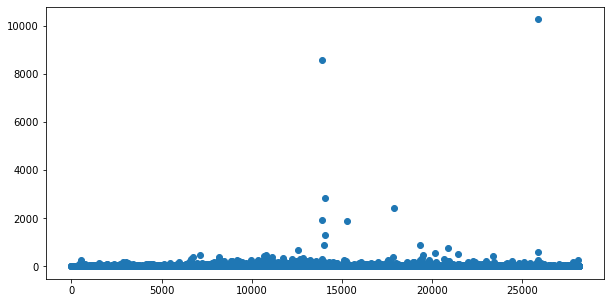

In [124]:
plt.figure(figsize = (10,5))
plt.scatter(list(df.index), lrdf['votes'])
plt.show()

In [152]:
lrdf.loc[lrdf['votes'].idxmax()]

total_imp_topics        4
votes               10279
Name: 25880, dtype: int64

In [153]:
lrdf['votes'].max()

10279

In [154]:
trial = lrdf

In [158]:
trial.sort_values(by=['votes'], ascending=False)

,total_imp_topics,votes
25880,4,10279
13914,3,8606
14050,2,2828
17877,5,2445
13893,3,1916
...,...,...
16527,4,0
16530,2,0
16531,3,0
16533,3,0


In [161]:
trial.drop([25880,13914], inplace=True)

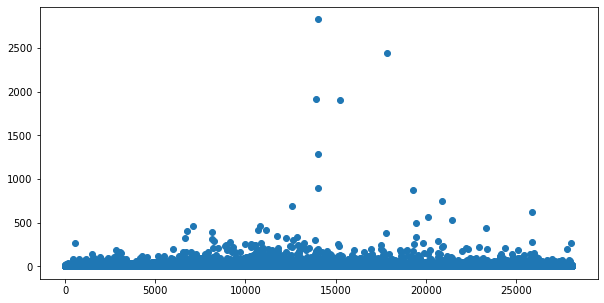

In [164]:
plt.figure(figsize = (10,5))
plt.scatter(list(trial.index), trial['votes'])
plt.show()

In [167]:
g = lrdf.groupby('total_imp_topics')

In [176]:
g.get_group(1)

,total_imp_topics,votes
8,1,0
12,1,0
14,1,0
20,1,0
34,1,5
...,...,...
28086,1,0
28096,1,1
28106,1,0
28118,1,3


In [182]:
for i in range(1,8):
    print(i, '---', g.get_group(i)['votes'].mean())

1 --- 1.7745689655172414
2 --- 2.9700871898054997
3 --- 6.288036634230108
4 --- 8.99968837644126
5 --- 14.506368197607102
6 --- 13.642701525054466
7 --- 5.411764705882353


In [130]:
lrdf['total_imp_topics'].value_counts()

3    8736
2    7455
4    6419
5    2591
1    2320
6     459
7     153
Name: total_imp_topics, dtype: int64

In [150]:
lrdfsort = lrdf.sort_values(by=['total_imp_topics'])

In [151]:
lrdfsort

,total_imp_topics,votes
14066,1,12
14599,1,0
14611,1,0
14651,1,0
14656,1,0
...,...,...
11700,7,0
5773,7,0
27817,7,1
27040,7,3
